# Environment:

In [1]:
!pip install torchvision
!pip install git+https://github.com/openai/CLIP.git

  Cloning https://github.com/openai/CLIP.git to /tmp/pip-req-build-s8s4oc4n
  Running command git clone --filter=blob:none --quiet https://github.com/openai/CLIP.git /tmp/pip-req-build-s8s4oc4n
  Resolved https://github.com/openai/CLIP.git to commit dcba3cb2e2827b402d2701e7e1c7d9fed8a20ef1
  Preparing metadata (setup.py) ... done
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 44.8/44.8 kB 2.1 MB/s eta 0:00:00
  Created wheel for clip: filename=clip-1.0-py3-none-any.whl size=1369489 sha256=70fef74fb471f7d96451a66697dc820efd2f8a6c39701df0a9f273512b1a112b
  Stored in directory: /tmp/pip-ephem-wheel-cache-b_n8n0da/wheels/da/2b/4c/d6691fa9597aac8bb85d2ac13b112deb897d5b50f5ad9a37e4
Successfully built clip


In [2]:
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt

In [3]:
import torch
import torchvision.transforms as transforms
from torchvision.datasets import Caltech256
from torch.utils.data import DataLoader
import torch.nn.functional as F
from torch.autograd import Function
from torchvision.utils import save_image
import clip
import os

In [4]:
from sklearn.metrics.pairwise import cosine_similarity
from PIL import Image

# Model and Data Initialization:

In [5]:
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

100%|████████████████████████████████████████| 338M/338M [00:02<00:00, 123MiB/s]


In [6]:
data_dir = './caltech256'
if not os.path.exists(data_dir):
    os.makedirs(data_dir)

# Loading dataset
caltech256 = Caltech256(root=data_dir, download=True, transform=preprocess)
dataloader = DataLoader(caltech256, shuffle=False)

Downloading...
From (original): https://drive.google.com/uc?id=1r6o0pSROcV1_VwT4oSjA2FBUSCWGuxLK
From (redirected): https://drive.usercontent.google.com/download?id=1r6o0pSROcV1_VwT4oSjA2FBUSCWGuxLK&confirm=t&uuid=387bda62-2961-470f-ade2-17f3a0fdc6b8
To: /content/caltech256/caltech256/256_ObjectCategories.tar
100%|██████████| 1.18G/1.18G [00:21<00:00, 55.7MB/s]


Extracting ./caltech256/caltech256/256_ObjectCategories.tar to ./caltech256/caltech256


# Encoding image into vectors with CLIP:

In [7]:
def encode_images(model, dataloader, device):
    all_features = []
    all_labels = []

    for images, labels in dataloader:
        images = images.to(device)

        # Encode images using CLIP
        with torch.no_grad():
            image_features = model.encode_image(images)

        # Store the vector representation
        all_features.append(image_features.cpu())
        all_labels.append(labels)

    all_features = torch.cat(all_features)
    all_labels = torch.cat(all_labels)

    return all_features, all_labels

In [8]:
encoded_features, labels = encode_images(model, dataloader, device)

print("Encoded Features Shape:", encoded_features.shape)
print("Labels Shape:", labels.shape)

Encoded Features Shape: torch.Size([30607, 512])
Labels Shape: torch.Size([30607])


# Content Based Image Retrieval:

## Query Image:

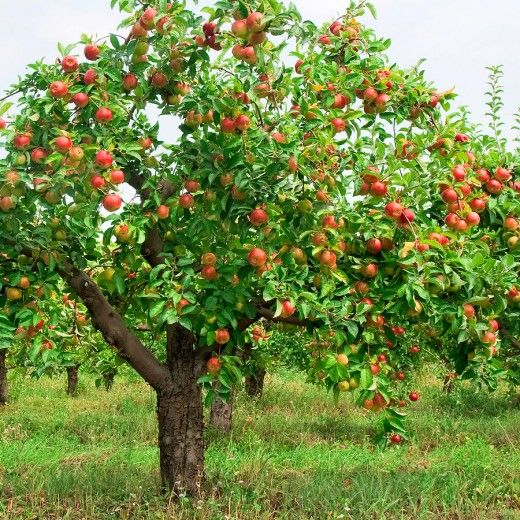

In [9]:
img = Image.open("/content/fruit_tree.jpg").convert("RGB")
img

In [10]:
img = preprocess(img).unsqueeze(0).to(device)  # Preprocess and add a batch dimension

with torch.no_grad():
    uploaded_image_features = model.encode_image(img)

In [11]:
similarities = cosine_similarity(uploaded_image_features.cpu(), encoded_features.cpu())
top_k_indices = similarities[0].argsort()[-5:][::-1]
top_k_indices

array([29803, 24866, 24832, 24893,  9927])


Top 5 similar images to the uploaded image:


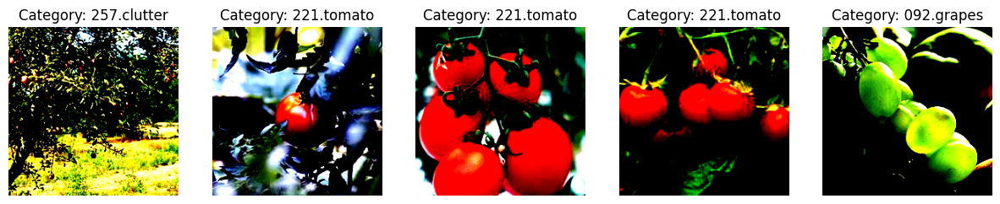

In [12]:
def display_similar_images(top_indices, dataset, labels):
    plt.figure(figsize=(15, 10))
    for i, idx in enumerate(top_indices):
        image, label = dataset[idx]
        plt.subplot(1, len(top_indices), i + 1)
        plt.imshow(image.permute(1, 2, 0))  # Permute the image for display (C, H, W) -> (H, W, C)
        plt.title(f"Category: {caltech256.categories[labels[idx]]}")
        plt.axis('off')
    plt.show()
print("\nTop 5 similar images to the uploaded image:")
display_similar_images(top_k_indices, dataloader.dataset, labels)

In [13]:
import os

def save_image_from_dataloader(dataloader, index, image_name):
    save_directory = '/content/retrieved_images/'

# Ensure the directory exists
    if not os.path.exists(save_directory):
        os.makedirs(save_directory)

    # Get the image tensor from the dataset
    image_tensor = dataloader.dataset[index][0]

    # Permute the tensor from (C, H, W) to (H, W, C)
    image_np = image_tensor.permute(1, 2, 0).cpu().numpy()  # Move to CPU and convert to NumPy array

    # Clamp the values to ensure they are in the range [0, 1] if they are not already
    image_np = np.clip(image_np, 0, 1)

    # Convert to uint8
    image_np = (image_np * 255).astype(np.uint8)

    # Save the image using plt.imsave
    plt.imsave(os.path.join(save_directory, image_name), image_np)

save_image_from_dataloader(dataloader, top_k_indices[0], "retrieved_1.jpg")

In [14]:
directory_path = 'content/retrieved_images'
if not os.path.exists(directory_path):
    os.makedirs(directory_path)

for i in range(5):
    image_name = f"retrieved_{i + 1}.jpg"
    save_image_from_dataloader(dataloader, top_k_indices[i], image_name)

## Dataset Images:

Select 100 random indices

In [15]:
random_indices = np.array([24583, 19039,  4831,  9273, 16800, 29076,  5022, 10268,  5936, 11362,  8232, 21388,  6053, 20966,  7731, 12956, 22771, 27212,
        6797,  7110, 24865,  2662, 16726, 25256, 24165,  3960, 12744, 1169, 10266, 17923, 19470, 16169,  3034,  8732, 18930, 13307,
       26230, 14472, 22488,  6360, 27823, 14078, 16026, 21599, 24334, 3582,   587, 23039, 15661, 22622,  6187, 27708, 20197, 24533,
       20833, 25945, 20525, 11697,  4274, 19717, 20440, 12930, 15839, 23285, 10379, 10589, 20980, 26897, 25352,  4007, 23378,  5837,
       30185, 14356, 18739, 12763, 19624, 14882, 13132,  2371, 15923, 12845, 29844,  9133,  3562, 30552, 20459, 23611, 24642, 24000,
        3460, 13625, 29261, 17575, 28474, 14462, 26141, 22206, 18451, 3673])
random_indices

array([24583, 19039,  4831,  9273, 16800, 29076,  5022, 10268,  5936,
       11362,  8232, 21388,  6053, 20966,  7731, 12956, 22771, 27212,
        6797,  7110, 24865,  2662, 16726, 25256, 24165,  3960, 12744,
        1169, 10266, 17923, 19470, 16169,  3034,  8732, 18930, 13307,
       26230, 14472, 22488,  6360, 27823, 14078, 16026, 21599, 24334,
        3582,   587, 23039, 15661, 22622,  6187, 27708, 20197, 24533,
       20833, 25945, 20525, 11697,  4274, 19717, 20440, 12930, 15839,
       23285, 10379, 10589, 20980, 26897, 25352,  4007, 23378,  5837,
       30185, 14356, 18739, 12763, 19624, 14882, 13132,  2371, 15923,
       12845, 29844,  9133,  3562, 30552, 20459, 23611, 24642, 24000,
        3460, 13625, 29261, 17575, 28474, 14462, 26141, 22206, 18451,
        3673])

Function that returns accuracy of each retrieval

In [16]:
def retrieve_similar_images(query_index, encoded_features, dataloader, labels, k=10, save_path="content/retrieved_images/"):
    """
    Retrieve, print, and save the top-k similar images based on cosine similarity, along with their labels.
    Returns a score indicating how many retrieved images share the same label as the query image.
    Also creates a DataFrame of the query image similarities.

    Args:
    - query_index (int): Index of the query image in the dataset.
    - encoded_features (torch.Tensor): Encoded features of all images in the dataset.
    - dataloader (torch.utils.data.DataLoader): Dataloader containing the dataset images.
    - labels (list): List of labels corresponding to the dataset images.
    - k (int): Number of similar images to retrieve (default is 10).
    - save_path (str): Path to save the retrieved images.

    Returns:
    - score (int): Number of retrieved images with the same label as the query image.
    - query_similarities (DataFrame): DataFrame containing similarities with all images.
    """

    dataset = dataloader.dataset

    # Convert encoded features to numpy if it's a tensor
    encoded_features_np = encoded_features.cpu().numpy() if isinstance(encoded_features, torch.Tensor) else encoded_features

    # Step 1: Extract the query image feature vector
    query_feature = encoded_features_np[query_index].reshape(1, -1)

    # Step 2: Compute cosine similarities between the query feature and all other features
    similarities = cosine_similarity(query_feature, encoded_features_np).flatten()

    # Step 3: Get the indices of the top-k most similar images (excluding the query image itself)
    top_k_indices = similarities.argsort()[-(k + 1):][::-1]  # Get k+1 to include the query image itself

    # Step 4: Create a folder to save the images
    query_folder = os.path.join(save_path, str(query_index + 1))
    os.makedirs(query_folder, exist_ok=True)

    # Step 5: Display the query image and the top-k similar images
    query_image, _ = dataset[query_index]  # Extract the query image from the dataset
    save_image(query_image, os.path.join(query_folder, 'query_image.png'))

    # Plot the query image
    plt.figure(figsize=(15, 5))
    plt.subplot(1, k + 1, 1)
    plt.imshow(query_image.permute(1, 2, 0))  # Change dimensions to HxWxC for plotting
    plt.title(f'Query Image\nLabel: {labels[query_index]}')
    plt.axis('off')

    # Initialize a list to store similarity data for the DataFrame
    similarity_data = []
    score = 0

    for i, idx in enumerate(top_k_indices[1:k + 1]):  # Skip the first one as it is the query image itself
        similar_image, _ = dataset[idx]  # Get the similar image
        plt.subplot(1, k + 1, i + 2)
        plt.imshow(similar_image.permute(1, 2, 0))  # Change dimensions to HxWxC for plotting
        plt.title(f"Rank {i + 1}\nLabel: {labels[idx]}")
        plt.axis('off')

        # Check if the label matches the query label
        if labels[idx] == labels[query_index]:
            score += 1

    # Create a similarity row for the DataFrame
    similarity_row = {
        'Query Image Index': query_index,
    }

    # Add similarity scores to the dictionary
    for idx, sim_score in enumerate(similarities):
        similarity_row[f'similarity_with_image_{idx + 1}'] = sim_score

    # Append the row to the similarity data list
    similarity_data.append(similarity_row)

    # Convert similarity data to DataFrame
    query_similarities = pd.DataFrame(similarity_data)

    # Save the DataFrame to CSV
    query_similarities.to_csv('/content/query_similarities.csv', index=False)

    plt.show()

    return score, query_similarities

Average it over all random_indices

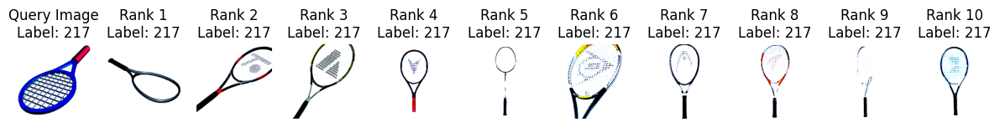

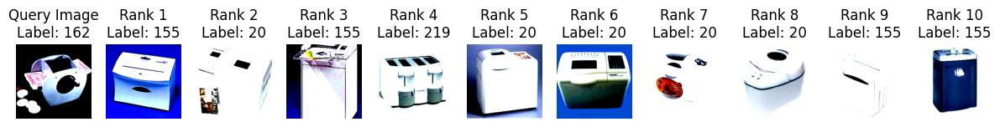

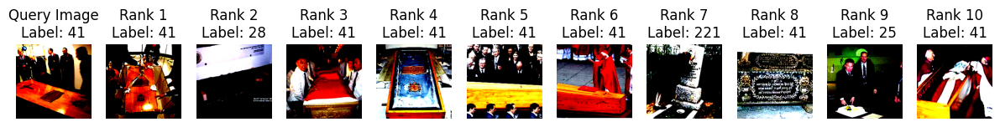

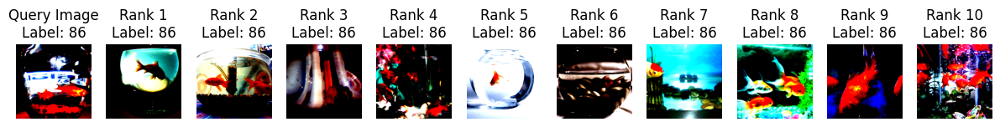

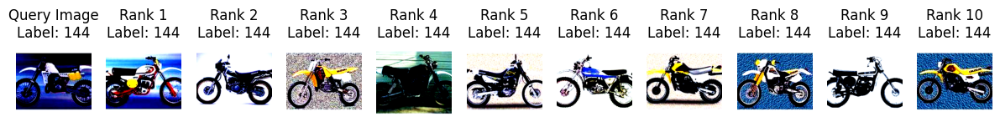

...

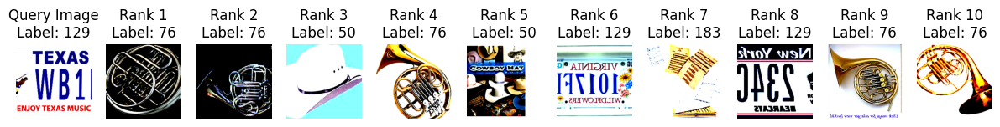

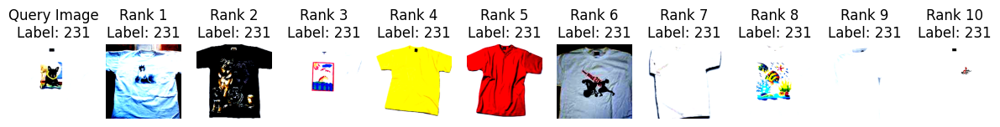

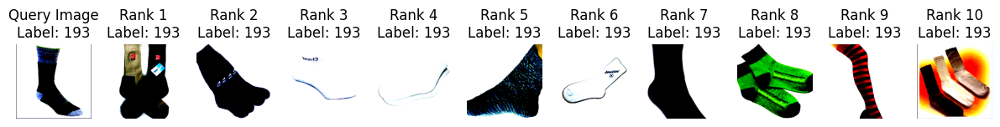

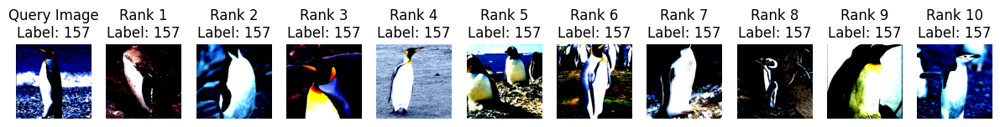

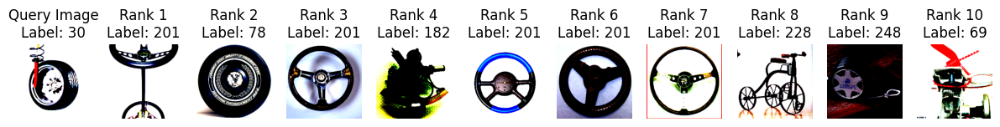

Accuracies for each query image: [10  0  7 10 10 10  8 10 10 10 10 10 10  9 10 10  7 10 10  8 10 10 10 10
 10 10  9 10 10  3 10 10 10 10 10 10 10 10  2  2  2 10 10 10 10  9 10  5
 10  5 10 10 10 10 10 10 10  8 10  9 10  9  0 10 10 10  7  1  3  6  8 10
 10 10  2  3 10  0  9 10  2 10 10 10  1 10 10  1  8 10  1  7 10 10 10  2
 10 10 10  0]


In [17]:
accuracies = []
query_similarities_list = []

for i, index in enumerate(random_indices):
    score, query_similarity = retrieve_similar_images(query_index=index, encoded_features=encoded_features, dataloader=dataloader, labels=labels, k=10)
    accuracies.append(score)
    query_similarities_list.append(query_similarity)

query_similarities = pd.concat(query_similarities_list, ignore_index=True)
query_similarities.to_csv('/content/query_similarities.csv', index=False)

accuracies_array = np.array(accuracies)
print("Accuracies for each query image:", accuracies_array)

In [18]:
np.mean(accuracies_array)

8.13

# LIME Explanation Model:

In [19]:
!pip install lime

     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 275.7/275.7 kB 8.2 MB/s eta 0:00:00
  Preparing metadata (setup.py) ... done
  Created wheel for lime: filename=lime-0.2.0.1-py3-none-any.whl size=283834 sha256=d405603b8438f67bcaf845f070b3cef39ba1998dafc936bda7977fa1bff96323
  Stored in directory: /root/.cache/pip/wheels/fd/a2/af/9ac0a1a85a27f314a06b39e1f492bee1547d52549a4606ed89
Successfully built lime


## Query Image:

In [20]:
import lime
from lime import lime_image
from skimage.segmentation import mark_boundaries

  0%|          | 0/1000 [00:00<?, ?it/s]

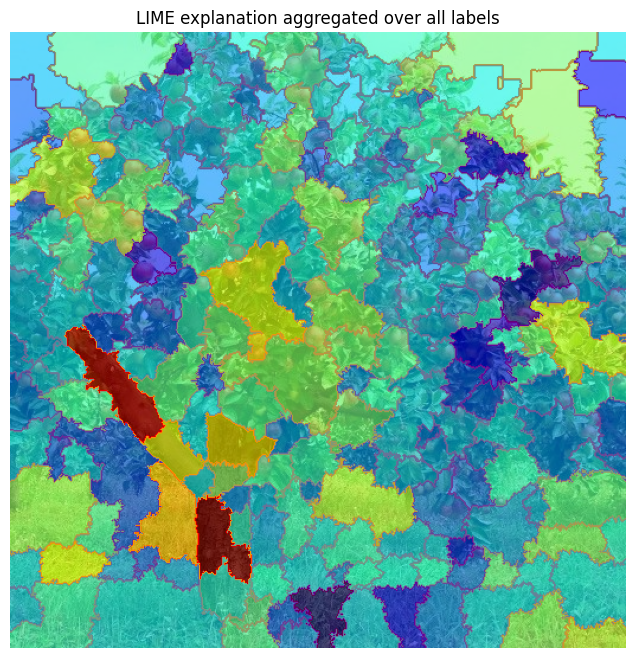

In [21]:
import clip
from PIL import Image
import torch
from lime import lime_image
from skimage.segmentation import mark_boundaries
import matplotlib.pyplot as plt
import numpy as np

# Load the CLIP model and the preprocessing function
device = "cuda" if torch.cuda.is_available() else "cpu"
model, preprocess = clip.load("ViT-B/32", device=device)

# Define a custom prediction function for LIME
def custom_clip_predict(images):
    # Preprocess and move images to the same device as the model
    processed_images = torch.stack([preprocess(Image.fromarray(image)).to(device) for image in images])

    # Get image embeddings
    with torch.no_grad():
        image_features = model.encode_image(processed_images)

    return image_features.cpu().numpy()  # Return embeddings on CPU

# LIME image explainer
explainer = lime_image.LimeImageExplainer()

# Load and convert the image
image_path = "/content/fruit_tree.jpg"
image = np.array(Image.open(image_path))

# Generate explanation for the image using LIME
explanation = explainer.explain_instance(
    image,
    custom_clip_predict,  # The custom prediction function
    top_labels=512,  # Use all labels
    hide_color=0,
    num_samples=100
)

# Initialize an empty mask for aggregating contributions across all labels
aggregate_mask = np.zeros_like(explanation.segments, dtype=float)

# Sum the superpixel contributions for each label
for label in range(len(explanation.local_exp)):  # Go through all labels in local_exp
    label_exp = explanation.local_exp[label]
    for superpixel, weight in label_exp:
        aggregate_mask[explanation.segments == superpixel] += weight

# Normalize the aggregate mask to values between 0 and 1
aggregate_mask -= aggregate_mask.min()  # Shift values to start at 0
aggregate_mask /= aggregate_mask.max()  # Scale to a maximum of 1

# Display the result
plt.figure(figsize=(8, 8))
plt.imshow(mark_boundaries(image, explanation.segments, color=(1, 0, 0)))  # Red boundaries
plt.imshow(aggregate_mask, cmap='jet', alpha=0.6)  # Overlay the average contributions
plt.title("LIME explanation aggregated over all labels")
plt.axis('off')
plt.show()


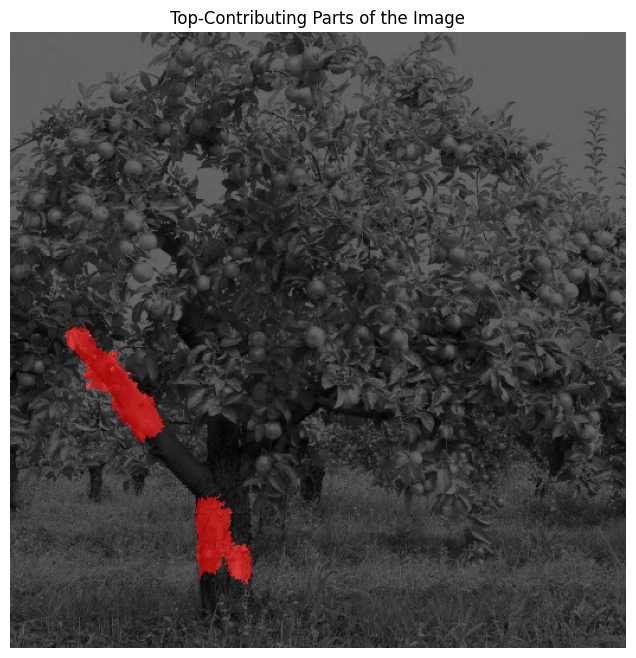

In [22]:
import numpy as np
import matplotlib.pyplot as plt
from skimage.segmentation import mark_boundaries
from skimage.color import label2rgb

threshold = 0.8  # 20% most important regions will be highlighted

# Identify regions with values above the threshold
contributing_mask = aggregate_mask >= threshold * aggregate_mask.max()

# Create a copy of the original image
highlighted_image = np.copy(image)

# Darken non-contributing parts of the image
highlighted_image[~contributing_mask] = (0, 0, 0)  # Set non-contributing areas to black
colored_contributions = label2rgb(contributing_mask, image=image, bg_label=0, colors=[(1, 0, 0)], alpha=0.6)

plt.figure(figsize=(8, 8))
plt.imshow(mark_boundaries(image, explanation.segments, color=(1, 0, 0)))  # Red boundaries around segments
plt.imshow(colored_contributions)  # Overlay most contributing regions
plt.title("Top-Contributing Parts of the Image")
plt.axis('off')
plt.show()

## Perturbation:

In [26]:
image_path = "/content/fruit_tree.jpg"
image = np.array(Image.open(image_path))

def lime_perturbation(image, output_path):
    explanation = explainer.explain_instance(
        image,
        custom_clip_predict,
        top_labels=512,
        hide_color=0,
        num_samples=100
    )
    aggregate_mask = np.zeros_like(explanation.segments, dtype=float)
    for label in range(len(explanation.local_exp)):
        label_exp = explanation.local_exp[label]
        for superpixel, weight in label_exp:
            aggregate_mask[explanation.segments == superpixel] += weight
    aggregate_mask -= aggregate_mask.min()
    aggregate_mask /= aggregate_mask.max()

    threshold = 0.8
    perturbation_mask = aggregate_mask >= threshold * aggregate_mask.max()
    perturbed_image = np.copy(image)
    perturbed_image[perturbation_mask] = (0, 0, 0)
    perturbed_image = Image.fromarray(perturbed_image.astype('uint8'))
    perturbed_image.save(output_path)
    print("Pertrubed image saved to ", output_path)

lime_perturbation(image, '/content/perturbed_image.png')

  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_image.png


## Retrieved Images:

In [27]:
explainer = lime_image.LimeImageExplainer()

# Directories for images and saving explanations
image_dir = '/content/retrieved_images'  # Path to your image directory
save_dir = '/content/lime_explanations'  # Directory to save explanations

# Create the save directory if it does not exist
if not os.path.exists(save_dir):
    os.makedirs(save_dir)

# Loop through all images in the directory
for image_name in os.listdir(image_dir):
    image_path = os.path.join(image_dir, image_name)

    if image_name.endswith('.jpg') or image_name.endswith('.png'):  # Process only image files
        print(f"Processing {image_name}...")

        # Load and preprocess the image
        image = np.array(Image.open(image_path))

        # Generate LIME explanation for the image, using all labels
        explanation = explainer.explain_instance(
            image,
            custom_clip_predict,
            top_labels=512,  # Using all labels for aggregation
            hide_color=0,
            num_samples=100
        )

        # Initialize an aggregate mask to accumulate contributions across all labels
        aggregate_mask = np.zeros_like(explanation.segments, dtype=float)

        # Accumulate contributions of each superpixel across all labels
        for label in explanation.top_labels:
            _, mask = explanation.get_image_and_mask(
                label,
                positive_only=True,
                num_features=5,
                hide_rest=False
            )
            aggregate_mask += mask.astype(float)

        # Normalize the aggregate mask to range [0, 1] for visualization
        aggregate_mask = aggregate_mask / aggregate_mask.max()

        # Generate a colored visualization of importance levels
        plt.figure(figsize=(8, 8))
        colored_mask = mark_boundaries(image, explanation.segments, color=(0, 0, 0))  # Mark boundaries
        plt.imshow(colored_mask, alpha=0.3)  # Light overlay of segment boundaries
        plt.imshow(aggregate_mask, cmap='jet', alpha=0.6)  # Multicolored mask with 'jet' colormap
        plt.title(f'Aggregated LIME Explanation for {image_name}')
        plt.axis('off')

        # Save the multicolored LIME explanation
        save_path = os.path.join(save_dir, f'aggregated_lime_multicolor_{image_name}')
        plt.savefig(save_path, bbox_inches='tight')
        plt.close()  # Close the plot to free memory
        print(f"Saved aggregated LIME explanation to {save_path}")

Processing retrieved_5.jpg...


  0%|          | 0/100 [00:00<?, ?it/s]

Saved aggregated LIME explanation to /content/lime_explanations/aggregated_lime_multicolor_retrieved_5.jpg
Processing retrieved_3.jpg...


  0%|          | 0/100 [00:00<?, ?it/s]

Saved aggregated LIME explanation to /content/lime_explanations/aggregated_lime_multicolor_retrieved_3.jpg
Processing retrieved_4.jpg...


  0%|          | 0/100 [00:00<?, ?it/s]

Saved aggregated LIME explanation to /content/lime_explanations/aggregated_lime_multicolor_retrieved_4.jpg
Processing retrieved_1.jpg...


  0%|          | 0/100 [00:00<?, ?it/s]

Saved aggregated LIME explanation to /content/lime_explanations/aggregated_lime_multicolor_retrieved_1.jpg
Processing retrieved_2.jpg...


  0%|          | 0/100 [00:00<?, ?it/s]

Saved aggregated LIME explanation to /content/lime_explanations/aggregated_lime_multicolor_retrieved_2.jpg


# Evaluation of LIME Explanation of Query Images:

## Perturbation of Query Images:

In [28]:
retrieved_folder = '/content/content/retrieved_images'
perturbed_folder = '/content/perturbed_query_images'

# Create the perturbed folder if it doesn't exist
if not os.path.exists(perturbed_folder):
    os.makedirs(perturbed_folder)

# Process each query image in the retrieved folder
for i in range(100):  # Loop from 0 to 99 for 100 images
    query_folder = os.path.join(retrieved_folder, str(random_indices[i] + 1))
    query_image_path = os.path.join(query_folder, 'query_image.png')
    img_temp = np.array(Image.open(query_image_path))

    # Define output path for perturbed image
    output_query_folder = os.path.join(perturbed_folder, str(random_indices[i] + 1))
    if not os.path.exists(output_query_folder):
        os.makedirs(output_query_folder)
    lime_perturbation(img_temp, output_query_folder+'/perturbed_query_image.png')

  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/24584/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/19040/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/4832/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/9274/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/16801/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/29077/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/5023/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/10269/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/5937/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/11363/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/8233/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/21389/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/6054/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/20967/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/7732/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/12957/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/22772/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/27213/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/6798/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/7111/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/24866/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/2663/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/16727/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/25257/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/24166/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/3961/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/12745/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/1170/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/10267/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/17924/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/19471/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/16170/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/3035/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/8733/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/18931/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/13308/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/26231/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/14473/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/22489/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/6361/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/27824/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/14079/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/16027/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/21600/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/24335/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/3583/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/588/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/23040/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/15662/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/22623/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/6188/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/27709/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/20198/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/24534/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/20834/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/25946/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/20526/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/11698/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/4275/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/19718/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/20441/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/12931/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/15840/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/23286/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/10380/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/10590/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/20981/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/26898/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/25353/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/4008/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/23379/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/5838/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/30186/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/14357/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/18740/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/12764/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/19625/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/14883/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/13133/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/2372/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/15924/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/12846/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/29845/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/9134/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/3563/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/30553/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/20460/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/23612/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/24643/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/24001/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/3461/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/13626/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/29262/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/17576/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/28475/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/14463/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/26142/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/22207/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/18452/perturbed_query_image.png


  0%|          | 0/100 [00:00<?, ?it/s]

Pertrubed image saved to  /content/perturbed_query_images/3674/perturbed_query_image.png


## New Retrievals based on Perturbed Images:

In [ ]:
# Folder containing the perturbed images
perturbed_folder = '/content/perturbed_query_images'

# Initialize a list to store similarity data
similarity_data = []

# Loop through each subfolder in the perturbed images folder
for folder_name in os.listdir(perturbed_folder):
    folder_path = os.path.join(perturbed_folder, folder_name)

    # Check if it's a directory
    if os.path.isdir(folder_path):
        # Load the perturbed image
        img_path = os.path.join(folder_path, 'perturbed_query_image.png')
        img = Image.open(img_path)
        img = preprocess(img).unsqueeze(0).to(device)

        # Encode the image and compute similarities
        with torch.no_grad():
            uploaded_image_features = model.encode_image(img)
        similarities = cosine_similarity(uploaded_image_features.cpu(), encoded_features.cpu())

        similarity_row = {
            'Query Image Index': folder_name,  # Use the folder name as the index
        }

        # Add similarity scores to the dictionary
        for idx, score in enumerate(similarities[0]):
            similarity_row[f'similarity_with_image_{idx + 1}'] = score

        # Append the row to the similarity data list
        similarity_data.append(similarity_row)

# Create a DataFrame from the list
perturbed_similarities = pd.DataFrame(similarity_data)

# Display the DataFrame
print(perturbed_similarities)

# Optionally, save the DataFrame to a CSV file
perturbed_similarities.to_csv('/content/perturbed_similarities.csv', index=False)

A dataframe of each perturbed query image with its cosine similarity with each dataset image (cos_perturbed) is saved

This can be compared to the cos_query dataframe to understand the impact of perturbation and hence the performance of saliency maps generated by TIRE

## cos_query VS cos_perturbed

query_similarities and perturbed_similarities have been initialised again from the downloaded csv files as the colab session had to be restarted. This enabled freeing space, and switching to CPU back from the T4 GPU for comparing cosine values

### Getting Data Ready

In [30]:
perturbed_similarities.shape == query_similarities.shape

True

In [31]:
np.unique(query_similarities['Query Image Index'])

array([  587,  1169,  2371,  2662,  3034,  3460,  3562,  3582,  3673,
        3960,  4007,  4274,  4831,  5022,  5837,  5936,  6053,  6187,
        6360,  6797,  7110,  7731,  8232,  8732,  9133,  9273, 10266,
       10268, 10379, 10589, 11362, 11697, 12744, 12763, 12845, 12930,
       12956, 13132, 13307, 13625, 14078, 14356, 14462, 14472, 14882,
       15661, 15839, 15923, 16026, 16169, 16726, 16800, 17575, 17923,
       18451, 18739, 18930, 19039, 19470, 19624, 19717, 20197, 20440,
       20459, 20525, 20833, 20966, 20980, 21388, 21599, 22206, 22488,
       22622, 22771, 23039, 23285, 23378, 23611, 24000, 24165, 24334,
       24533, 24583, 24642, 24865, 25256, 25352, 25945, 26141, 26230,
       26897, 27212, 27708, 27823, 28474, 29076, 29261, 29844, 30185,
       30552])

In [32]:
np.unique(perturbed_similarities['Query Image Index'])

array(['10267', '10269', '10380', '10590', '11363', '11698', '1170',
       '12745', '12764', '12846', '12931', '12957', '13133', '13308',
       '13626', '14079', '14357', '14463', '14473', '14883', '15662',
       '15840', '15924', '16027', '16170', '16727', '16801', '17576',
       '17924', '18452', '18740', '18931', '19040', '19471', '19625',
       '19718', '20198', '20441', '20460', '20526', '20834', '20967',
       '20981', '21389', '21600', '22207', '22489', '22623', '22772',
       '23040', '23286', '23379', '23612', '2372', '24001', '24166',
       '24335', '24534', '24584', '24643', '24866', '25257', '25353',
       '25946', '26142', '26231', '2663', '26898', '27213', '27709',
       '27824', '28475', '29077', '29262', '29845', '30186', '3035',
       '30553', '3461', '3563', '3583', '3674', '3961', '4008', '4275',
       '4832', '5023', '5838', '588', '5937', '6054', '6188', '6361',
       '6798', '7111', '7732', '8233', '8733', '9134', '9274'],
      dtype=object)

In [33]:
query_similarities['Query Image Index'] = query_similarities['Query Image Index'] + 1

### Comparison:

In [34]:
query_sim = query_similarities.drop(columns=['Query Image Index'])
perturbed_sim = perturbed_similarities.drop(columns=['Query Image Index'])

CBIR Perturbation Fidelity = Summation |cos_perturbed – cos_query| / N

In [35]:
absolute_differences = np.abs(query_sim.values - perturbed_sim.values)
N = query_sim.shape[1]
fidelity_per_query = np.sum(absolute_differences, axis=1) / N
cbir_pert_fidelity = np.mean(fidelity_per_query)
cbir_pert_fidelity

0.07348670218317309

CBIR Ranking Consistency = 1 – 1/k  ×|{ i ∈ R_query  ∩ R_perturbed }|

In [36]:
k = 25
ranking_consistency = []

for i in range(query_sim.shape[0]):

    # Get the top-k indices based on cosine similarity for query and perturbed images
    top_k_query = query_sim.iloc[i].nlargest(k).index
    top_k_perturbed = perturbed_sim.iloc[i].nlargest(k).index

    # Find the intersection (common indices) between R_query and R_perturbed
    common_indices = set(top_k_query).intersection(set(top_k_perturbed))

    # Calculate the ranking consistency for this query image
    consistency = 1 - (len(common_indices) / k)
    ranking_consistency.append(consistency)

# Calculate the average CBIR Ranking Consistency across all query images
cbir_rank_consistency = np.mean(ranking_consistency)
cbir_rank_consistency

0.9955999999999999

In [37]:
K = [1,5,10,25,50,100,200,500]
cbir_rank_consistencies = []
for k in K:
    ranking_consistency = []
    for i in range(query_sim.shape[0]):

        # Get the top-k indices based on cosine similarity for query and perturbed images
        top_k_query = query_sim.iloc[i].nlargest(k).index
        top_k_perturbed = perturbed_sim.iloc[i].nlargest(k).index

        # Find the intersection (common indices) between R_query and R_perturbed
        common_indices = set(top_k_query).intersection(set(top_k_perturbed))

        # Calculate the ranking consistency for this query image
        consistency = 1 - (len(common_indices) / k)
        ranking_consistency.append(consistency)

    # Calculate the average CBIR Ranking Consistency across all query images
    cbir_rank_consistency = np.mean(ranking_consistency)
    cbir_rank_consistencies.append(cbir_rank_consistency)

cbir_rank_consistencies

[1.0,
 0.998,
 0.997,
 0.9955999999999999,
 0.9925999999999999,
 0.987,
 0.9763999999999998,
 0.94632]

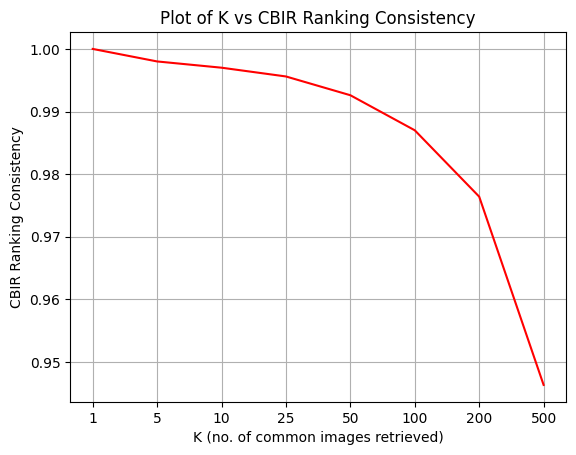

In [38]:
x_positions = list(range(len(K)))
plt.plot(x_positions, cbir_rank_consistencies, linestyle='-', color='r')
plt.xticks(x_positions, K)
plt.xlabel('K (no. of common images retrieved)')
plt.ylabel('CBIR Ranking Consistency')
plt.title('Plot of K vs CBIR Ranking Consistency')
plt.grid(True)
plt.show()